<a href="https://colab.research.google.com/github/mickymult/LLM-Architecture/blob/main/LLM_ArchitectureVisual.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>



---


# **Model Summary:**

Provide a summary of the model's architecture, including the number of parameters, layers, and attention heads.

Display the model's training and evaluation metrics if available.


---



In [54]:
!pip install transformers
import torch

In [55]:
from transformers import GPT2LMHeadModel
model_name = 'gpt2-medium'
model = GPT2LMHeadModel.from_pretrained(model_name)

In [56]:
# Number of parameters
total_parameters = sum(p.numel() for p in model.parameters())

# Number of layers
num_layers = model.config.n_layer

# Number of attention heads per layer
num_attention_heads = model.config.n_head

# Number of neurons (or dimensions) per layer
num_neurons = model.config.n_embd

# Model type
model_type = model.config.model_type

# Vocabulary size
vocab_size = model.config.vocab_size

In [57]:
print(f"Model Name: {model_name}")
print("This is the identifier of the model and can be used to download pre-trained weights or configurations.")

print(f"Model Type: {model_type}")
print("The type of the model (e.g., GPT-2, BERT) determines its architecture and potential applications.")

print(f"Total Parameters: {total_parameters}")
print("Parameters are individual pieces of information the model learns from data. More parameters can increase model capacity but also risk overfitting.")

print(f"Number of Layers: {num_layers}")
print("Layers in a model allow it to learn hierarchical representations. Deeper models (more layers) can capture more complex patterns but are computationally heavier.")

print(f"Number of Attention Heads per Layer: {num_attention_heads}")
print("Attention heads allow the model to focus on different parts of the input. More heads increase the capacity to capture various aspects of the input.")

print(f"Number of Neurons (Dimensions) per Layer: {num_neurons}")
print("Neurons process and transmit information in the model. More neurons can increase model capacity, but also computational requirements.")

print(f"Vocabulary Size: {vocab_size}")
print("This represents the number of unique tokens (words, characters, subwords) the model can recognize. A larger vocabulary can capture finer nuances in language.")


Model Name: gpt2-medium
This is the identifier of the model and can be used to download pre-trained weights or configurations.
Model Type: gpt2
The type of the model (e.g., GPT-2, BERT) determines its architecture and potential applications.
Total Parameters: 354823168
Parameters are individual pieces of information the model learns from data. More parameters can increase model capacity but also risk overfitting.
Number of Layers: 24
Layers in a model allow it to learn hierarchical representations. Deeper models (more layers) can capture more complex patterns but are computationally heavier.
Number of Attention Heads per Layer: 16
Attention heads allow the model to focus on different parts of the input. More heads increase the capacity to capture various aspects of the input.
Number of Neurons (Dimensions) per Layer: 1024
Neurons process and transmit information in the model. More neurons can increase model capacity, but also computational requirements.
Vocabulary Size: 50257
This repr



---


# **Visualizing Neuron Activations**


---



In [58]:
from transformers import GPT2Tokenizer, GPT2Model

tokenizer = GPT2Tokenizer.from_pretrained('gpt2-medium')

# Initialize the model and tokenizer
model = GPT2Model.from_pretrained('gpt2-medium', output_hidden_states=True, output_attentions=True)

model.eval()

def extract_activations_and_attention(text):
    # Tokenize the input and get the outputs from the model
    inputs = tokenizer(text, return_tensors="pt")
    with torch.no_grad():
        outputs = model(**inputs)

    # Get the hidden states (activations) from the outputs
    # There's one for each layer of the model
    activations = outputs.hidden_states

    # Get the attention scores from the outputs
    attentions = outputs.attentions

    return activations, attentions


text = "The quick brown fox jumped over the lazy dog."
activations, attentions = extract_activations_and_attention(text)

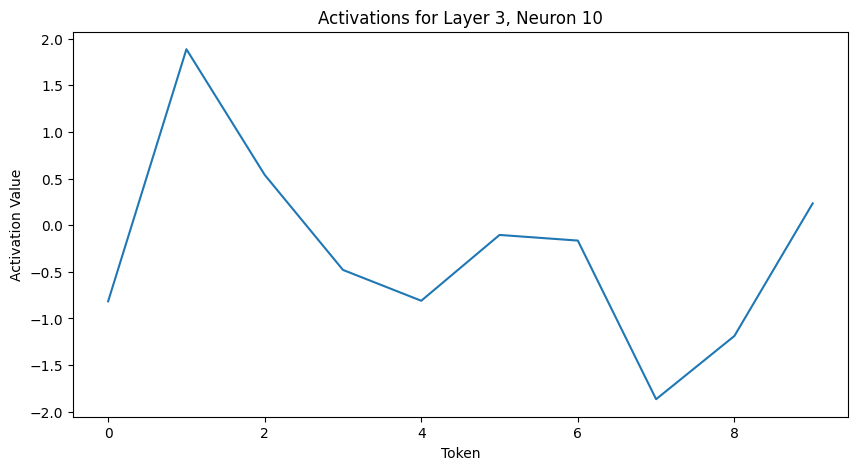

In [59]:
import matplotlib.pyplot as plt

# Choose a specific layer and neuron
layer_idx = 3
neuron_idx = 10

# Extract the activations for the chosen layer and neuron across all tokens
activation_values = activations[layer_idx][0, :, neuron_idx].numpy()

# Plot
plt.figure(figsize=(10, 5))
plt.plot(activation_values)
plt.title(f"Activations for Layer {layer_idx}, Neuron {neuron_idx}")
plt.xlabel("Token")
plt.ylabel("Activation Value")
plt.show()


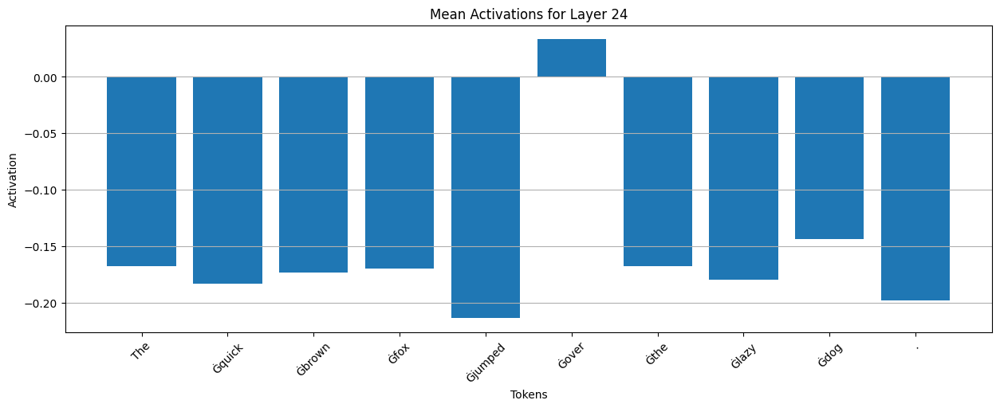

In [30]:
import matplotlib.pyplot as plt
import numpy as np

def plot_activations_for_layer(text, layer_num):
    # Extract activations and attentions
    activations, _ = extract_activations_and_attention(text)

    # Get the tokens
    tokens = tokenizer.tokenize(text)

    # Extract activations for the desired layer
    layer_activations = activations[layer_num][0].detach().numpy()

    # Compute the mean activation per token
    mean_activations = np.mean(layer_activations, axis=1)

    # Plot
    plt.figure(figsize=(15, 5))
    plt.bar(tokens, mean_activations)
    plt.title(f'Mean Activations for Layer {layer_num}')
    plt.xlabel('Tokens')
    plt.ylabel('Activation')
    plt.xticks(rotation=45)
    plt.grid(axis='y')
    plt.show()

# Example usage:
plot_activations_for_layer(text, 24)




---


# **Attention Maps:**

Display how each token attends to every other token in multi-head attention. This can be a heatmap where rows represent query tokens and columns represent key tokens.

Allows users to select a specific attention head or layer to view detailed attention patterns.


---



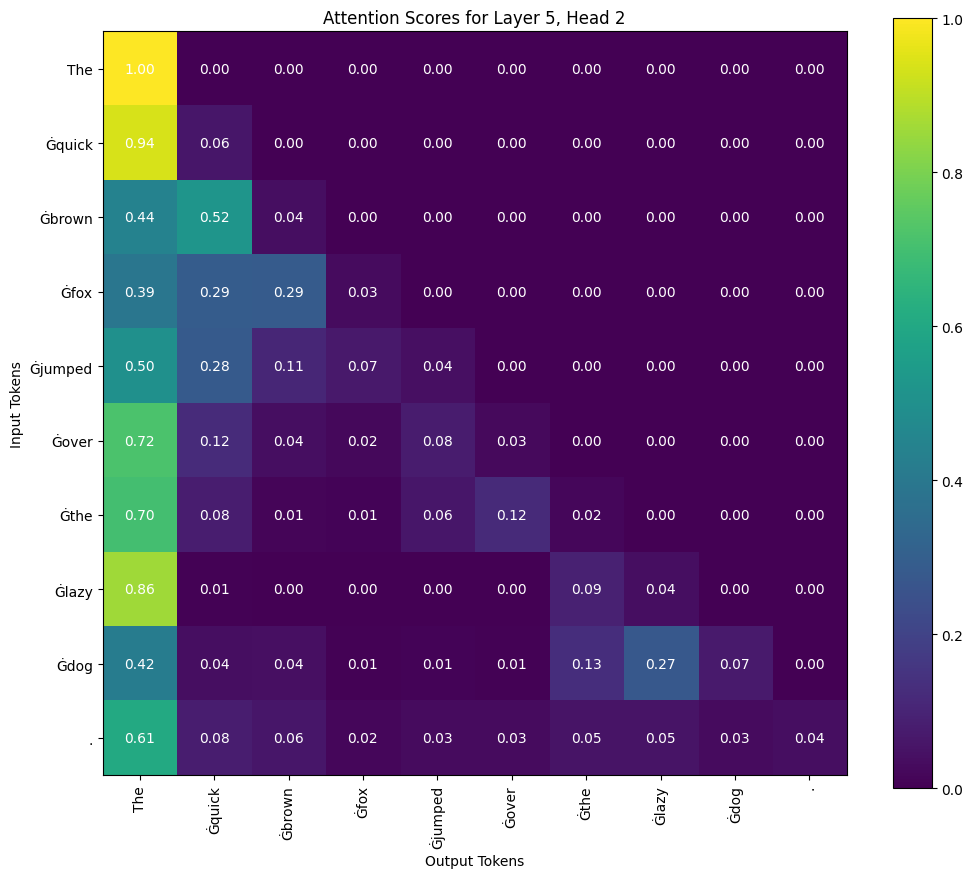

In [33]:
import numpy as np
import matplotlib.pyplot as plt

# Tokenize the sentence
tokens = tokenizer.tokenize(text)

# Choose a specific layer and head
layer_idx = 5
head_idx = 2

# Extract the attention scores for the chosen layer and head
attention_values = attentions[layer_idx][0, head_idx].numpy()

# Plot
plt.figure(figsize=(12, 10))
cax = plt.imshow(attention_values, cmap='viridis')
plt.colorbar(cax)

# Annotate each cell with the attention score
for i in range(attention_values.shape[0]):
    for j in range(attention_values.shape[1]):
        plt.text(j, i, f'{attention_values[i, j]:.2f}', ha='center', va='center', color='w')

plt.title(f"Attention Scores for Layer {layer_idx}, Head {head_idx}")
plt.xticks(np.arange(len(tokens)), tokens, rotation=90)
plt.yticks(np.arange(len(tokens)), tokens)
plt.xlabel("Output Tokens")
plt.ylabel("Input Tokens")
plt.show()




---


# **Visualizing the 3D Architecture of GPT-2**


---




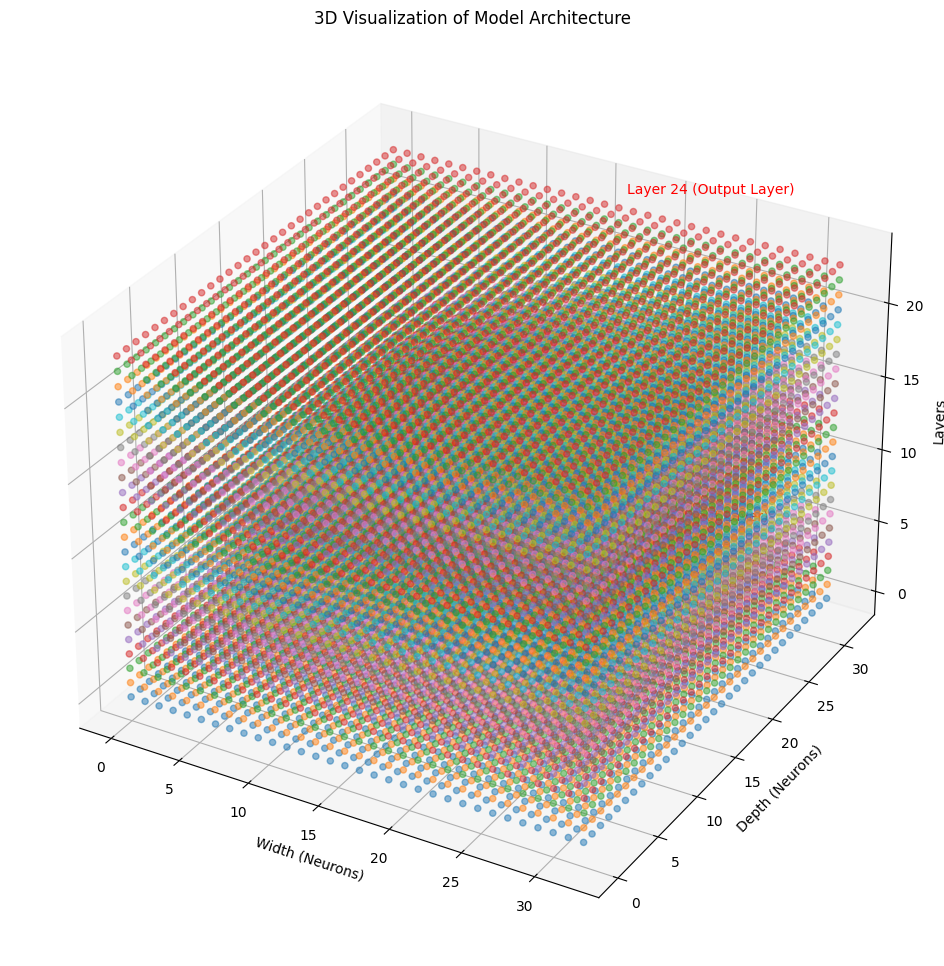

In [ ]:
def plot_3d_model_architecture(num_layers, num_neurons):
    fig = plt.figure(figsize=(12, 12))
    ax = fig.add_subplot(111, projection='3d')

    # Define a grid for neuron placement within each layer
    grid_size = int(np.sqrt(num_neurons))
    x_vals = np.linspace(0, grid_size, grid_size)
    y_vals = np.linspace(0, grid_size, grid_size)
    X, Y = np.meshgrid(x_vals, y_vals)
    X = X.flatten()
    Y = Y.flatten()

    # For each layer
    for layer in range(num_layers):
        z = [layer] * num_neurons  # All neurons on the same layer
        ax.scatter(X, Y, z, marker='o', s=20, depthshade=True, alpha=0.5)

        # Annotate the first and last layers
        if layer == 0:
            ax.text(grid_size/2, grid_size + 2, layer, "Layer 0 (Input Layer)", color='red')
        elif layer == num_layers - 1:
            ax.text(grid_size/2, grid_size + 2, layer, f"Layer {num_layers} (Output Layer)", color='red')

    ax.set_xlabel('Width (Neurons)')
    ax.set_ylabel('Depth (Neurons)')
    ax.set_zlabel('Layers')
    ax.set_title('3D Visualization of Model Architecture')

    plt.show()

plot_3d_model_architecture(num_layers, num_neurons)


In [60]:
def get_activations(sentence, model):
    # Tokenize input and obtain model outputs
    inputs = tokenizer(sentence, return_tensors="pt")

    with torch.no_grad():
        outputs = model(**inputs)

    # Extract hidden states (layers x batch x sequence_length x hidden_size)
    hidden_states = outputs.hidden_states
    return hidden_states

In [61]:
def visualize_activations(sentence, model, num_layers, num_neurons):
    activations = get_activations(sentence, model)

    # Neuron placement
    grid_size = int(np.sqrt(num_neurons))
    x_vals = np.linspace(0, grid_size, grid_size)
    y_vals = np.linspace(0, grid_size, grid_size)
    X, Y = np.meshgrid(x_vals, y_vals)
    X = X.flatten()
    Y = Y.flatten()

    # Tokenization details
    tokens = tokenizer.tokenize(sentence)
    token_info = f"Sentence: {sentence}<br>Tokenized: {' '.join(tokens)}<br>Number of Tokens: {len(tokens)}"

    traces = []
    for layer in range(num_layers):
        Z = [layer] * num_neurons
        # Average activation across sequence length
        avg_activation = activations[layer][0].mean(dim=0).numpy()
        colors = avg_activation - avg_activation.min()
        colors /= colors.max()  # Normalize to range [0,1]
        hovertext = ["Activation: {:.4f}".format(val) for val in avg_activation]
        trace = go.Scatter3d(x=X, y=Y, z=Z, mode='markers', name=f"Layer {layer}",
                             marker=dict(size=3, opacity=0.6, color=colors, colorscale='Viridis'),
                             hovertext=hovertext, hoverinfo="text")
        traces.append(trace)

    # Model and Tokenization Info
    model_info_text = f"GPT-2 Medium Model<br>Layers: {num_layers}<br>Neurons per Layer: {num_neurons}<br>Attention Heads per Layer: 16<br><br>{token_info}"
    annotation_trace = go.Scatter3d(x=[0], y=[grid_size], z=[num_layers], text=[model_info_text], mode='text', showlegend=False, textfont=dict(size=10))
    traces.append(annotation_trace)

    layout = go.Layout(title="3D Visualization of GPT-2 Model Activations",
                       scene=dict(aspectmode='cube',
                                  xaxis_title="Width (Neurons)",
                                  yaxis_title="Depth (Neurons)",
                                  zaxis_title="Layers"))

    fig = go.Figure(data=traces, layout=layout)
    fig.show()

sentence = "The quick brown fox jumps over the lazy dog."
visualize_activations(sentence, model, 24, 1024)


In [62]:
import plotly.graph_objects as go

def animate_token_propagation(sentence, model, num_layers, num_neurons):
    activations = get_activations(sentence, model)

    # Neuron placement
    grid_size = int(np.sqrt(num_neurons))
    x_vals = np.linspace(0, grid_size, grid_size)
    y_vals = np.linspace(0, grid_size, grid_size)
    X, Y = np.meshgrid(x_vals, y_vals)
    X = X.flatten()
    Y = Y.flatten()

    # Tokenization details
    tokens = tokenizer.tokenize(sentence)

    frames = []
    for token_idx, token in enumerate(tokens):
        traces = []
        for layer in range(num_layers):
            Z = [layer] * num_neurons
            token_activation = activations[layer][0, token_idx].numpy()
            colors = token_activation - token_activation.min()
            colors /= colors.max()
            hovertext = ["Activation: {:.4f}".format(val) for val in token_activation]
            trace = go.Scatter3d(x=X, y=Y, z=Z, mode='markers', name=f"Layer {layer}",
                                 marker=dict(size=3, opacity=0.6, color=colors, colorscale='Viridis'),
                                 hovertext=hovertext, hoverinfo="text")
            traces.append(trace)

        frame = go.Frame(data=traces, name=token)
        frames.append(frame)

    layout = go.Layout(title="Token Propagation Animation through GPT-2 Model",
                       scene=dict(aspectmode='cube',
                                  xaxis_title="Width (Neurons)",
                                  yaxis_title="Depth (Neurons)",
                                  zaxis_title="Layers"),
                       updatemenus=[dict(type='buttons', showactive=False, buttons=[dict(label='Play', method='animate', args=[None, dict(frame=dict(duration=1000, redraw=True), fromcurrent=True)])])])

    fig = go.Figure(data=frames[0]['data'], layout=layout, frames=frames)
    fig.show()

sentence = "The quick brown fox jumps over the lazy dog."
animate_token_propagation(sentence, model, 24, 1024)


In [63]:
import plotly.graph_objects as go

# Set the padding token for the GPT-2 tokenizer
tokenizer.pad_token = tokenizer.eos_token

def get_activations(sentence, model):
    inputs = tokenizer(sentence, return_tensors="pt", truncation=True, padding=True)
    with torch.no_grad():
        outputs = model(**inputs, output_hidden_states=True)  # Explicitly request hidden states
    return outputs.hidden_states

def animate_token_propagation_layer_by_layer(sentence, model, num_layers, num_neurons):
    activations = get_activations(sentence, model)

    # Neuron placement
    grid_size = int(np.sqrt(num_neurons))
    x_vals = np.linspace(0, grid_size, grid_size)
    y_vals = np.linspace(0, grid_size, grid_size)
    X, Y = np.meshgrid(x_vals, y_vals)
    X = X.flatten()
    Y = Y.flatten()

    # Tokenization details
    tokens = tokenizer.tokenize(sentence)

    frames = []
    for layer in range(num_layers):
        traces = []
        for token_idx, token in enumerate(tokens):
            Z = [layer] * num_neurons
            token_activation = activations[layer][0, token_idx].numpy()
            colors = token_activation - token_activation.min()
            colors /= colors.max()
            hovertext = ["Activation: {:.4f}".format(val) for val in token_activation]
            trace = go.Scatter3d(x=X, y=Y, z=Z, mode='markers', name=f"Token {token}",
                                 marker=dict(size=3, opacity=0.6, color=colors, colorscale='Viridis'),
                                 hovertext=hovertext, hoverinfo="text")
            traces.append(trace)

        frame = go.Frame(data=traces, name=f"Layer {layer}")
        frames.append(frame)

    layout = go.Layout(title="Token Propagation Animation through GPT-2 Model",
                       scene=dict(aspectmode='cube',
                                  xaxis_title="Width (Neurons)",
                                  yaxis_title="Depth (Neurons)",
                                  zaxis_title="Layers"),
                       updatemenus=[dict(type='buttons', showactive=False, buttons=[dict(label='Play', method='animate', args=[None, dict(frame=dict(duration=1000, redraw=True), fromcurrent=True)])])])

    fig = go.Figure(data=frames[0]['data'], layout=layout, frames=frames)
    fig.show()

sentence = "The quick brown fox jumps over the lazy dog."
animate_token_propagation_layer_by_layer(sentence, model, 24, 1024)


In [64]:
import plotly.graph_objects as go
from transformers import GPT2Tokenizer, GPT2Model
import torch

tokenizer = GPT2Tokenizer.from_pretrained('gpt2-medium')
model = GPT2Model.from_pretrained('gpt2-medium')

# Set the padding token for the GPT-2 tokenizer
tokenizer.pad_token = tokenizer.eos_token

def get_activations(sentence, model):
    inputs = tokenizer(sentence, return_tensors="pt", truncation=True, padding=True)
    with torch.no_grad():
        outputs = model(**inputs, output_hidden_states=True)  # Explicitly request hidden states
    return outputs.hidden_states

def animate_token_propagation_with_token_info(sentence, model, num_layers, num_neurons):
    activations = get_activations(sentence, model)

    # Tokenization details
    tokens = tokenizer.tokenize(sentence)
    num_tokens = len(tokens)

    # Adjust the neuron placement
    grid_size = int(np.sqrt(num_neurons // num_tokens))
    frames = []
    for layer in range(num_layers):
        traces = []
        for token_idx, token in enumerate(tokens):
            x_vals = np.linspace(token_idx * grid_size, (token_idx + 1) * grid_size, grid_size)
            y_vals = np.linspace(0, grid_size, grid_size)
            X, Y = np.meshgrid(x_vals, y_vals)
            X = X.flatten()
            Y = Y.flatten()

            Z = [layer] * len(X)
            token_activation = activations[layer][0, token_idx].numpy()[:len(X)]
            colors = token_activation - token_activation.min()
            colors /= colors.max()

            # Modify hovertext to show both token and its activation value
            hovertext = [f"Token: {token} | Activation: {val:.4f}" for val in token_activation]

            trace = go.Scatter3d(x=X, y=Y, z=Z, mode='markers', name=f"Token {token}",
                                 marker=dict(size=3, opacity=0.6, color=colors, colorscale='Viridis'),
                                 hovertext=hovertext, hoverinfo="text")
            traces.append(trace)

        frame = go.Frame(data=traces, name=f"Layer {layer}")
        frames.append(frame)

    layout = go.Layout(title="Token Propagation Animation through GPT-2 Model",
                       scene=dict(aspectmode='cube',
                                  xaxis_title="Width (Neurons)",
                                  yaxis_title="Depth (Neurons)",
                                  zaxis_title="Layers"),
                       updatemenus=[dict(type='buttons', showactive=False, buttons=[dict(label='Play', method='animate', args=[None, dict(frame=dict(duration=1000, redraw=True), fromcurrent=True)])])])

    fig = go.Figure(data=frames[0]['data'], layout=layout, frames=frames)
    fig.show()

sentence = "The quick brown fox jumps over the lazy dog."
animate_token_propagation_with_token_info(sentence, model, 24, 1024)


In [65]:
import plotly.graph_objects as go
from transformers import GPT2Tokenizer, GPT2LMHeadModel
import torch
import numpy as np

tokenizer = GPT2Tokenizer.from_pretrained('gpt2-medium')
model = GPT2LMHeadModel.from_pretrained('gpt2-medium')
tokenizer.pad_token = tokenizer.eos_token

def get_activations_and_attentions(sentence, model):
    inputs = tokenizer(sentence, return_tensors="pt", truncation=True, padding=True)
    with torch.no_grad():
        outputs = model(**inputs, output_hidden_states=True, output_attentions=True)
    return outputs.hidden_states, outputs.attentions

def animate_token_propagation_layer_by_layer(sentence, model, num_layers, num_neurons_sampled):
    activations, _ = get_activations_and_attentions(sentence, model)

    # Sample a subset of neurons for visualization
    sampled_indices = np.random.choice(1024, num_neurons_sampled, replace=False)

    grid_size = int(np.sqrt(num_neurons_sampled))
    x_vals = np.linspace(0, grid_size, grid_size)
    y_vals = np.linspace(0, grid_size, grid_size)
    X, Y = np.meshgrid(x_vals, y_vals)
    X = X.flatten()
    Y = Y.flatten()

    tokens = tokenizer.tokenize(sentence)

    all_traces = []
    frames = []
    for layer in range(num_layers):
        traces = []
        token_idx = 2  # let's focus on a single token for simplicity, you can change this index
        token = tokens[token_idx]
        Z = [layer] * num_neurons_sampled
        token_activation = activations[layer][0, token_idx, sampled_indices].numpy()
        colors = token_activation - token_activation.min()
        colors /= colors.max()
        hovertext = [f"Token: {token}, Activation: {val:.4f}" for val in token_activation]
        trace = go.Scatter3d(x=X, y=Y, z=Z, mode='markers', name=f"Token {token}",
                             marker=dict(size=3, opacity=0.6, color=colors, colorscale='Viridis'),
                             hovertext=hovertext, hoverinfo="text", visible=(layer == 0))
        traces.append(trace)
        all_traces.extend(traces)
        frame = go.Frame(data=traces, name=f"Layer {layer}")
        frames.append(frame)

    steps = []
    for layer in range(num_layers):
        step = dict(method="restyle", args=["visible", [False] * num_layers], label=f"Layer {layer}")
        step["args"][1][layer] = True
        steps.append(step)

    sliders = [dict(active=0, pad={"t": 1}, steps=steps)]

    layout = go.Layout(title="Token Propagation Animation through GPT-2 Model",
                       scene=dict(aspectmode='cube',
                                  xaxis_title="Width (Neurons)",
                                  yaxis_title="Depth (Neurons)",
                                  zaxis_title="Layers"),
                       sliders=sliders)

    fig = go.Figure(data=all_traces, frames=frames, layout=layout)
    fig.show()

sentence = "The quick brown fox jumps over the lazy dog."
animate_token_propagation_layer_by_layer(sentence, model, 24, 64)  # Sampling only 64 neurons for visualization




---


# **Projecting Token Embeddings to 2D/3D Space**


---



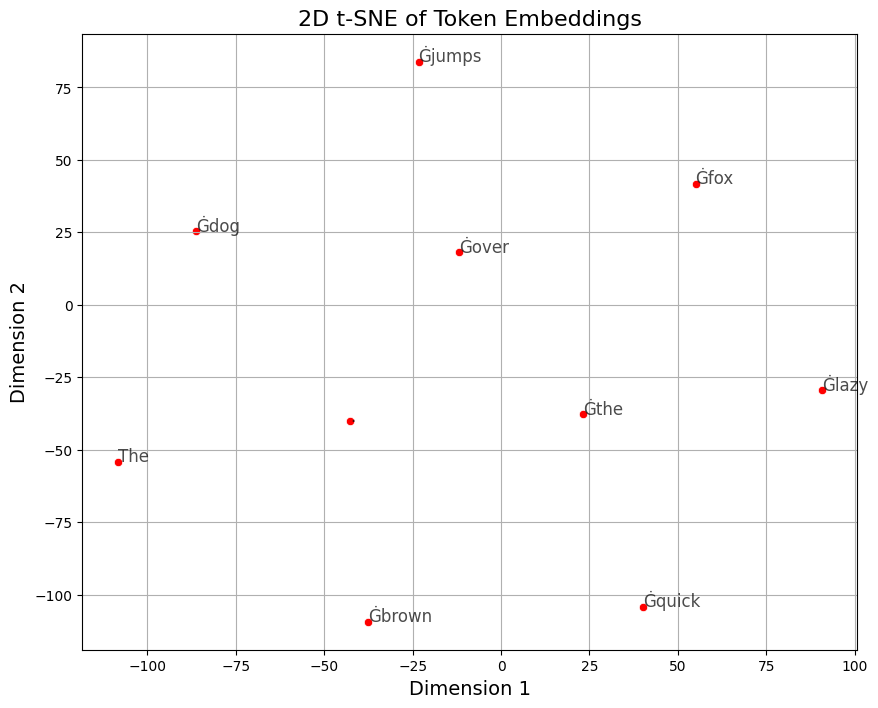

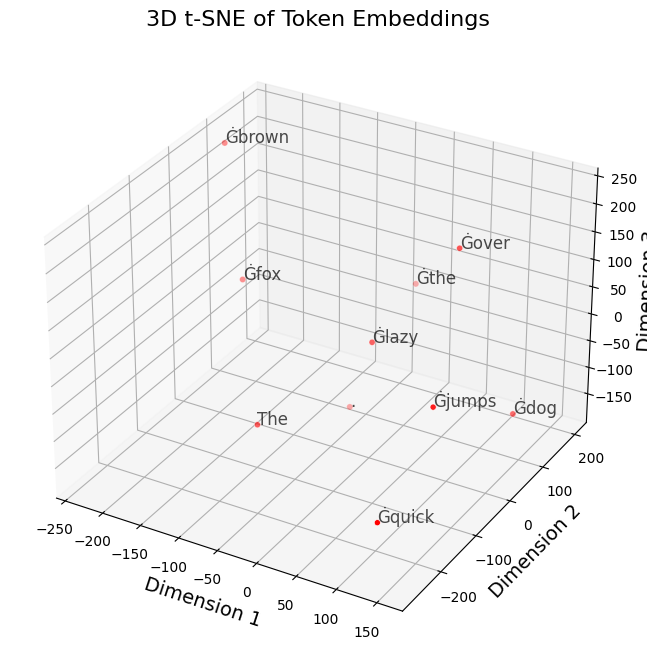

In [8]:
import torch
import plotly.express as px
import numpy as np
import matplotlib.pyplot as plt
from transformers import GPT2Tokenizer, GPT2LMHeadModel
from sklearn.manifold import TSNE

# Initialize the GPT-2 tokenizer and model
tokenizer = GPT2Tokenizer.from_pretrained('gpt2-medium')
model = GPT2LMHeadModel.from_pretrained('gpt2-medium')
tokenizer.pad_token = tokenizer.eos_token

def get_token_embeddings(sentence, model):
    inputs = tokenizer(sentence, return_tensors="pt", truncation=True, padding=True)
    with torch.no_grad():
        outputs = model(**inputs, output_hidden_states=True)
    # Extract embeddings from the last hidden state
    embeddings = outputs.hidden_states[-1][0].numpy()
    return embeddings, tokenizer.tokenize(sentence)

def plot_2d(tsne_2d, tokens):
    plt.figure(figsize=(10, 8))
    plt.scatter(tsne_2d[:, 0], tsne_2d[:, 1], c='red', edgecolors='w', linewidth=0.5)
    for i, token in enumerate(tokens):
        plt.annotate(token, (tsne_2d[i, 0], tsne_2d[i, 1]), fontsize=12, alpha=0.7)
    plt.xlabel('Dimension 1', fontsize=14)
    plt.ylabel('Dimension 2', fontsize=14)
    plt.title('2D t-SNE of Token Embeddings', fontsize=16)
    plt.grid(True)
    plt.show()

def plot_3d(tsne_3d, tokens):
    fig = plt.figure(figsize=(10, 8))
    ax = fig.add_subplot(111, projection='3d')
    scatter = ax.scatter(tsne_3d[:, 0], tsne_3d[:, 1], tsne_3d[:, 2], c='red', edgecolors='w', linewidth=0.5)
    for i, token in enumerate(tokens):
        ax.text(tsne_3d[i, 0], tsne_3d[i, 1], tsne_3d[i, 2], token, fontsize=12, alpha=0.7)
    ax.set_xlabel('Dimension 1', fontsize=14)
    ax.set_ylabel('Dimension 2', fontsize=14)
    ax.set_zlabel('Dimension 3', fontsize=14)
    ax.set_title('3D t-SNE of Token Embeddings', fontsize=16)
    plt.show()

# Get the token embeddings
sentence = "The quick brown fox jumps over the lazy dog."
embeddings, tokens = get_token_embeddings(sentence, model)

# Apply t-SNE for dimensionality reduction
tsne_2d = TSNE(n_components=2, perplexity=min(30, len(tokens) - 1)).fit_transform(embeddings)
tsne_3d = TSNE(n_components=3, perplexity=min(30, len(tokens) - 1)).fit_transform(embeddings)

# Visualize the results
plot_2d(tsne_2d, tokens)
plot_3d(tsne_3d, tokens)



---


# **Gradients and Saliency:**

Visualize gradients of output with respect to input tokens to understand which tokens have the most influence on the output.

This is especially useful for classification tasks to understand which parts of the input are most influential.


---



In [16]:
import torch
from transformers import GPT2Tokenizer, GPT2LMHeadModel
import matplotlib.pyplot as plt
import numpy as np

In [17]:
tokenizer = GPT2Tokenizer.from_pretrained('gpt2-medium')
model = GPT2LMHeadModel.from_pretrained('gpt2-medium')
model.eval()  # Set the model to evaluation mode

GPT2LMHeadModel(
  (transformer): GPT2Model(
    (wte): Embedding(50257, 1024)
    (wpe): Embedding(1024, 1024)
    (drop): Dropout(p=0.1, inplace=False)
    (h): ModuleList(
      (0-23): 24 x GPT2Block(
        (ln_1): LayerNorm((1024,), eps=1e-05, elementwise_affine=True)
        (attn): GPT2Attention(
          (c_attn): Conv1D()
          (c_proj): Conv1D()
          (attn_dropout): Dropout(p=0.1, inplace=False)
          (resid_dropout): Dropout(p=0.1, inplace=False)
        )
        (ln_2): LayerNorm((1024,), eps=1e-05, elementwise_affine=True)
        (mlp): GPT2MLP(
          (c_fc): Conv1D()
          (c_proj): Conv1D()
          (act): NewGELUActivation()
          (dropout): Dropout(p=0.1, inplace=False)
        )
      )
    )
    (ln_f): LayerNorm((1024,), eps=1e-05, elementwise_affine=True)
  )
  (lm_head): Linear(in_features=1024, out_features=50257, bias=False)
)

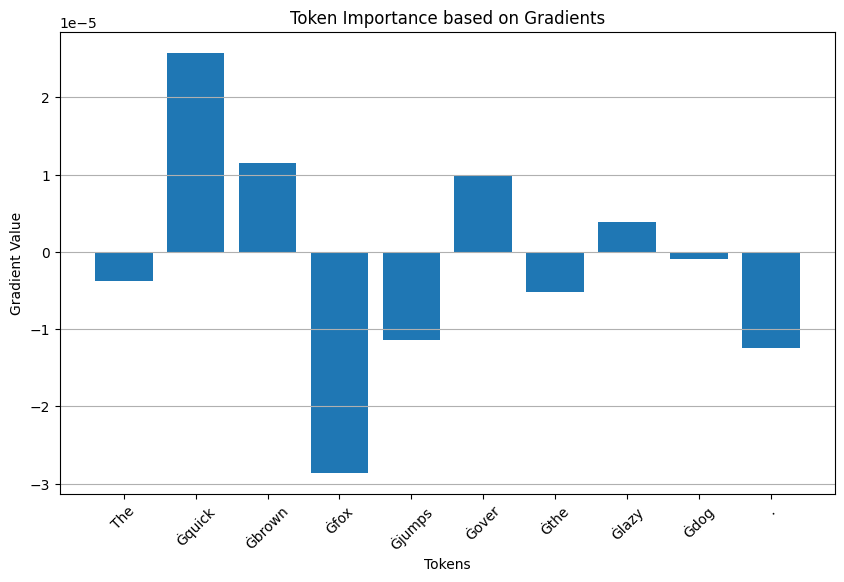

In [19]:
# Get embeddings
model.zero_grad()
embeddings = model.transformer.wte(input_ids)
embeddings = embeddings.clone().detach().requires_grad_(True)

# Forward pass
outputs = model(inputs_embeds=embeddings)
logits = outputs.logits

# Get the prediction for the last token
predicted_token_idx = logits[0, -1, :].argmax().item()
predicted_token_logit = logits[0, -1, predicted_token_idx]

# Backward pass
predicted_token_logit.backward()

# Extract gradients
gradients = embeddings.grad[0].sum(dim=1).numpy()

# Visualization
tokens = tokenizer.tokenize(sentence)
plt.figure(figsize=(10, 6))
plt.bar(tokens, gradients)
plt.xlabel('Tokens')
plt.ylabel('Gradient Value')
plt.title('Token Importance based on Gradients')
plt.xticks(rotation=45)
plt.grid(axis='y')
plt.show()